<a href="https://colab.research.google.com/github/RaudelVargasUIC/CS_418_Final_Report/blob/main/418_Final_Report.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Github Link





---


https://github.com/RaudelVargasUIC/CS_418_Final_Report


**New_Excels/New_Excels**: This is the folder that contains all of the data we used in their separate excel files.

**cleaning_418_proj.py**: This file looped through all of the excel files we got from IDOC, read it as a CSV using pandas, and add it do our combined_data.csv file.

**cleaning_csv_cols.py**: This file drops unnecessary columns, which were filled with garbage data. It also converts the sentence dates and custody dates to datetime.




---



FULLY CLEANED CODE IN DRIVE:
https://drive.google.com/drive/folders/1D2KfRF1X3t0gHAtJ_MZ8N0wON8fIpKSS?usp=drive_link

The files we added in our github clean the original excel files we used, which ever is easier for you guys to use :)

# Project Introduction

The criminal justice system is a complex system to try to understand, and it is difficult to keep up with different parts of the system, unless someone is directly involved within it. Analyzing different trends within data allows us to gain a deeper understanding to this complex system, giving us the ability to understand trends with incarcerations, pick out specific areas that need reform, and hopefully give us a good understanding of areas that need reform.
Prison systems pose complex challenges, even in Illinois. The Illinois prison system is a broken system, facing many issues such as overcrowding, racial bias, offenders likely reoffending after being released (recidivism), and too much money being spent on prisons. Understanding patterns from prison statistics may allow us to find a solution to these issues. Leveraging data science techniques will allows us to uncover trends, hidden insights, and potentially find valuable recommendations to create a more just and effective criminal justice system.
This project utilizes a dataset of Illinois prison statistics, containing information on inmate demographics, type of offesnes, sentence durations, recidivism, and more.
Using a combination of exploratory data analysis, data visualizations, and machine learning, we aim to answer this critical question:
In Illinois, which crimes are the most committed, who commits those crimes, how to the sentences differ based on who committed that crime, and how likely is that crime to be repeated?

# Data

All of our data is from the Illinois Department of Corrections ([link](https://idoc.illinois.gov/reportsandstatistics/prison-population-data-sets.html)), and they have excel files for various months within a year. We decided to only use the excel files for December of each year, as there were a lot of repeated columns. It made it easier for us as it limited the number of files we needed to import and clean, while also keeping a majority of rows that were crucial for our analysis. We combined these files into one major CSV file, and did some basic cleaning to make sure the data was all in the same format. An issue with this data was that somewhere along the way in recording it, they would change the format in some of the columns, so we needed to make sure that it was as consistent as possible.

To clean the data, we used two small scripts, cleaning_418_proj.py and cleaning_csv_cols.py.

# Visualizations

First, we needed to connect the drive and install all of the dependencies

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install --upgrade pip
!pip install --upgrade geopandas

!pip install numpy==1.22.4
!pip install plotly-geo==1.0.0
!pip install geopandas==0.9.0
!pip install pyshp==1.2.10
!pip install shapely==1.7.1
!pip install plotly==5.18.0
!pip install gitly==1.0.1

**Code for setting up the main dataframe from the CSV file**

In [ ]:
import glob
import pandas as pd
import seaborn as sns
import numpy as np
import plotly.figure_factory as ff
import plotly.express as px
from matplotlib import pyplot as plt
from pandas.plotting import scatter_matrix
import matplotlib.pyplot as plt

In [ ]:
csv_files = glob.glob("/content/drive/MyDrive/CS 418/Final Combined CSV/*.{}".format('csv'))

df = pd.DataFrame()

for csv in csv_files:
  df = df.append(pd.read_csv(csv))

df

<ipython-input-4-72f704b78c9c>:6: DtypeWarning: Columns (2,6,9,10,16) have mixed types. Specify dtype option on import or set low_memory=False.
  df = df.append(pd.read_csv(csv))
<ipython-input-4-72f704b78c9c>:6: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.read_csv(csv))


,IDOC #,Name,Date of Birth,Sex,Race,Veteran Status,Current Admission Date,Admission Type,Parent Institution,Projected Mandatory Supervised Release (MSR) Date3,Projected Discharge Date3,Custody Date,Sentence Date,Crime Class,Holding Offense,Sentence Years,Sentence Months,Truth in Sentencing,Sentencing County
0,A00090,"BUELL, JOHN JR",6031944.0,Male,White,No,1092002.0,Discharged & recommitted,Pontiac CC,NaN,NaN,2001-12-19 00:00:00,2001-12-19 00:00:00,Class X,PREDATORY CRIMINAL SEXUAL ASSAULT,0013,0.0,85%,Winnebago
1,A00147,"MCCUTCHEON, JOHN",6141949.0,Male,White,Yes,2161983.0,Discharged & recommitted,Menard CC,NaN,NaN,1983-21-51 00:00:00,1983-21-51 00:00:00,Class X,RAPE,0050,0.0,Day-for-Day,Jasper
2,A00360,"BELL, HOWARD",12181946.0,Male,White,No,2261988.0,Discharged & recommitted,Stateville CC,NaN,NaN,1988-22-31 00:00:00,1988-22-31 00:00:00,Class X,ARMED ROBBERY,0060,0.0,Day-for-Day,Cook
3,A01054,"TIPTON, DARNELL",3251954.0,Male,Black,No,12231988.0,"Parole violator, New sentence",Stateville CC,NaN,NaN,1987-80-71 00:00:00,1987-80-71 00:00:00,Class X,AGG CRIM SEX ASSAULT/WEAPON,0060,0.0,Day-for-Day,Cook
4,A01072,"BRISBON, HENRY",1121956.0,Male,Black,No,2221974.0,Direct from court,Pontiac CC,NaN,NaN,1982-22-41 00:00:00,1982-22-41 00:00:00,Murder,MURDER/INTENT TO KILL/INJURE,LIFE,NaN,Day-for-Day,Will
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
792155,Y44037,"SERVIN, ROBERT C.",1995-08-21 00:00:00,Male,White,No,2020-12-18 00:00:00,Direct from court,Stateville,2022-03-18 00:00:00,2024-03-18 00:00:00,2020-11-09 00:00:00,2020-11-09 00:00:00,Class 2,POSSESSION OF STOLEN FIREARM,0003,00,Day-for-Day,Woodford
792156,Y44038,"BOGNER, NICHOLAS",1998-10-22 00:00:00,Male,White,No,2020-12-18 00:00:00,Direct from court,Stateville,2022-10-21 00:00:00,2024-10-21 00:00:00,2020-11-30 00:00:00,2020-11-30 00:00:00,Class 2,BURGLARY,0004,00,Day-for-Day,Woodford
792157,Y44039,"SANDERS, ROBERT R.",1971-08-28 00:00:00,Male,White,No,2020-12-18 00:00:00,Direct from court,Menard,2028-04-01 00:00:00,2030-04-01 00:00:00,2020-11-18 00:00:00,2020-11-18 00:00:00,Class 1,AGG ROBBERY/INDICATE ARM W/FIR,0015,00,Day-for-Day,Johnson
792158,Y44040,"BEASLEY, JAMES R.",1965-07-16 00:00:00,Male,Black,No,2020-12-18 00:00:00,Direct from court,Menard,2022-06-10 00:00:00,2023-06-10 00:00:00,2020-11-19 00:00:00,2020-11-19 00:00:00,Class 3,POSSESSION OF METH< 5 GRAMS,0004,00,Day-for-Day,Massac


**MOST POPULAR CRIMES COMMITTED PER COUNTY - Kacper Mocarski**


---



**Hypothesis to test**: Crimes that relate to harming others are more likely to occur in more populated counties, while non-harming crimes are more likely to be committed in less populated counties. We thought this hypothesis would be interesting to pursure because we were curious to see what the number one committed crime was in each county. We were also curious to see that if you have a county with a larger population, are non-harming crimes more common than harming crimes.

**Findings:** In this graph, we can see that counties towards the middle and border of Illinois away from the northwest have the burglary or possessions of some sort of drugs as their most committed crimes since 2005. Counties closer to Chicago have crimes related to murder or sexual assault as their most committed crimes. There are a sprinkle of burglaries and drug possession near that area, but the more populated counties have crimes related to harming others.

In [ ]:
# Read in the data to get the FIPS
df_sample = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/minoritymajority.csv')
df_sample = df_sample[df_sample['STNAME'] == 'Illinois']

df_sample = df_sample.sort_values(by="CTYNAME", ascending=True)
fips = df_sample['FIPS'].tolist()

In [ ]:
county_crimes = df[["Sentencing County", "Holding Offense", "Sentence Date"]]

# Changing date to be >= 2005
county_crimes["Sentence Date"] = pd.to_datetime(county_crimes["Sentence Date"], errors="coerce")
county_crimes = county_crimes[county_crimes["Sentence Date"].notna()]
county_crimes["Year"] = county_crimes["Sentence Date"].dt.year
county_crimes = county_crimes[county_crimes["Year"] >= 2005]


# Removing duplicate counties, based on inconsistencies in spelling in CSV
county_crimes = county_crimes[county_crimes["Sentencing County"] != "Out of state"]
county_crimes = county_crimes[county_crimes["Sentencing County"] != "Dupage"]
county_crimes = county_crimes[county_crimes["Sentencing County"] != "Dekalb"]
county_crimes = county_crimes[county_crimes["Sentencing County"] != "LaSalle"]

# Grouping by [county, crime], and then seeing the count for each crime
county_crimes = county_crimes.groupby(["Sentencing County", "Holding Offense"]).size().reset_index(name="Count")
county_crimes = county_crimes.sort_values("Count", ascending=False).drop_duplicates("Sentencing County")
county_crimes = county_crimes.sort_values("Sentencing County", ascending=True)

values = county_crimes["Holding Offense"].tolist()

county_crimes

,Sentencing County,Holding Offense,Count
133,Adams,BURGLARY,173
390,Alexander,BURGLARY,41
571,Bond,POSSESSION OF METH< 5 GRAMS,66
827,Boone,PREDATORY CRIMINAL SEXUAL ASSAULT,101
881,Brown,BURGLARY,8
...,...,...,...
20717,Whiteside,BURGLARY,225
21291,Will,MANU/DEL 01-15 GRAMS COCAINE,617
21593,Williamson,BURGLARY,71
21973,Winnebago,BURGLARY,712


In [ ]:
fig = ff.create_choropleth(
    values= values,
    fips=fips,
    scope=['Illinois'],
    title='Crime Heatmap of Illinois Counties',
    show_state_data = True,
    legend_title= 'Types of Crimes Committed per County (Since 2005)'
    # colorscale=colorscale,
)
fig.update_layout(legend=dict(
    orientation="v",
    yanchor="top",
    y=1,
    xanchor="right",  # changed
    x= .35,
    borderwidth = 1,
    bordercolor = 'black',
    ))
fig.show()

This code is needed for the plotly graph to show up in github

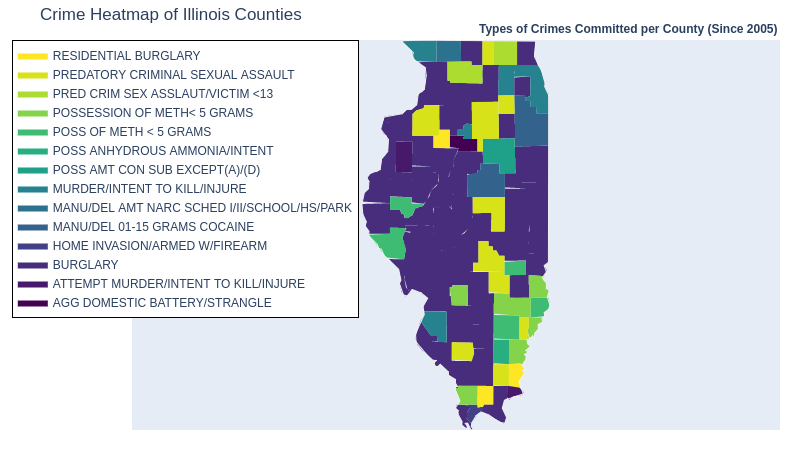

In [ ]:
from gitly.colab.plot import GitlyPlotter
gitly = GitlyPlotter('github')
gitly.show(fig)

**AVERAGE AGE OF MOST COMMITTED CRIMES per county - Kacper Mocarski**


---
**What we want to find:** We were able to see which crimes offenders were sentenced to prison for most often, so we became curious to see who was committing those crimes. This would help us see if certain crimes are more popular due to age demographics, or if certain counties have similar ages for offenders.

**Findings:** This graph shows us that the average age of offenders was relatively similar for most crimes, with a few outliers as well. The circles' size are supposed to be related to the average age, and the graphs show a very similar size for all circles, meaning the average ages are very similar. One other finding the graph  



In [ ]:
from datetime import datetime

age_county = df[["Sentencing County", "Date of Birth", "Sentence Date"]]
# Changing date to be >= 2005
age_county["Sentence Date"] = pd.to_datetime(age_county["Sentence Date"], errors="coerce")
age_county = age_county[age_county["Sentence Date"].notna()]
age_county["Year"] = age_county["Sentence Date"].dt.year
age_county = age_county[age_county["Year"] >= 2005]

# Changing the DOB to be in Datatime format
age_county["Date of Birth"] = pd.to_datetime(age_county["Date of Birth"], errors="coerce")
age_county = age_county[age_county["Date of Birth"].notna()]

# Get the age of offenders by doing current date - dob
current_date = datetime.now()
age_county["Age"] = ((current_date - age_county['Date of Birth']).dt.days/365).astype(int)

#Getting average and number of crimes per county
age_county = age_county.groupby("Sentencing County").agg({'Age': 'mean', 'Year': 'count'}).reset_index()

age_county

,Sentencing County,Age,Year
0,Adams,43.897849,3534
1,Alexander,46.137405,393
2,Bond,42.525659,721
3,Boone,43.446756,2019
4,Brown,45.150000,80
...,...,...,...
101,Whiteside,44.615675,2118
102,Will,45.428524,12067
103,Williamson,46.215625,1280
104,Winnebago,44.926744,13446


In [ ]:
fig = px.scatter(age_county, x='Age', y='Year', size='Age',
                 color='Sentencing County',
                 labels={'Age': 'Average Age of Offenders', 'Year': 'Number of Crimes'},
                 title='Average Age and Number of Crimes by Sentencing County',
                 hover_data=['Age', 'Year', 'Sentencing County'])

fig.update_layout(
    xaxis_title='Number of Crimes',
    yaxis_title='Average Age of Offenders',
    showlegend=True
)

fig.show()

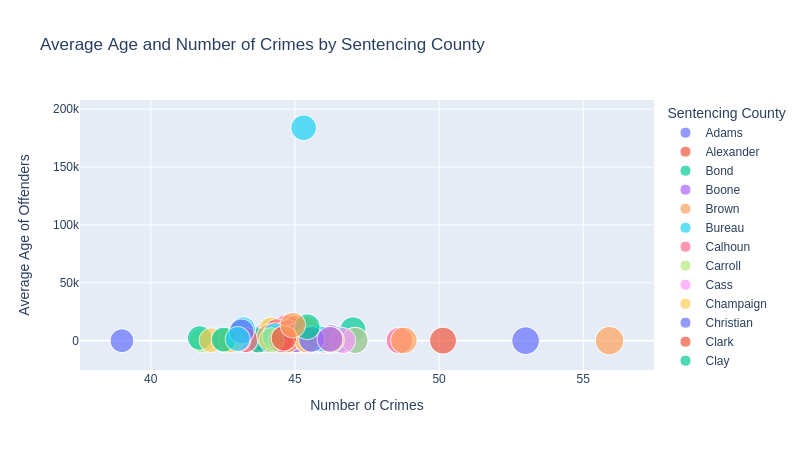

In [ ]:
# for github
gitly.show(fig)

**AVERAGE SENTENCE PERIOD | MINORITIES VS NON-MINORITIES - Raudel**


---
**Hypothesis to test**: Minorities are likely to have a longer average sentence period for crimes than non-minorities.

We thought this was an interesting hypothesis to test because we believed that there is a lot of racial disparity when it comes to sentencing times for certain races. There have been multiple articles and movements trying to bring up the harshness in prison sentences for minorities compared to non-minorities, especially in lower level crimes (i.e. non-murder crimes).

**Findings**: This graph doesn't really support the claim of the hypothesis. If anything, the average prison sentencing in Illinois is very even, except for murder and sexual assault, which are slightly more spread out than the other crimes.



In [ ]:
# Get the top five crimes by count
top_five_crimes = df[["Holding Offense"]]
top_five_crimes = top_five_crimes.groupby(["Holding Offense"]).size().reset_index(name="Count")
top_five_crimes = top_five_crimes.sort_values(by="Count", ascending=False)
top_five_crimes = top_five_crimes.head(5)

top_five_list = top_five_crimes["Holding Offense"].tolist()
top_five_list

In [ ]:
pop_offenses = df[["Sentence Years", "Holding Offense", "Race"]]

# change Sentence Years to be ints and LIFE = 90
pop_offenses["Sentence Years"] = np.where(pop_offenses["Sentence Years"] == "LIFE", 90, pop_offenses["Sentence Years"])
pop_offenses = pop_offenses[pop_offenses["Sentence Years"] != "SDP"]
pop_offenses = pop_offenses[pop_offenses["Sentence Years"] != "DEATH"]
pop_offenses = pop_offenses[pop_offenses["Sentence Years"] != "PEND"]
pop_offenses = pop_offenses[pop_offenses["Sentence Years"] != " "]
pop_offenses = pop_offenses[pop_offenses["Sentence Years"].notna()]

pop_offenses["Sentence Years"] = pop_offenses["Sentence Years"].astype(int)

# Grouping by Race and Holding Offense
pop_offenses = pop_offenses.groupby(["Race", "Holding Offense"])["Sentence Years"].mean().reset_index(name="Average")
pop_offenses = pop_offenses[pop_offenses["Holding Offense"].isin(top_five_list)]

pop_offenses

,Race,Holding Offense,Average
60,American Indian,BURGLARY,6.537500
127,American Indian,MURDER/INTENT TO KILL/INJURE,58.152381
135,American Indian,POSS AMT CON SUB EXCEPT(A)/(D),1.736842
145,American Indian,PREDATORY CRIMINAL SEXUAL ASSAULT,13.333333
151,American Indian,RESIDENTIAL BURGLARY,8.750000
297,Asian,BURGLARY,4.764706
411,Asian,MURDER/INTENT TO KILL/INJURE,47.212237
417,Asian,POSS AMT CON SUB EXCEPT(A)/(D),1.727273
446,Asian,PREDATORY CRIMINAL SEXUAL ASSAULT,14.074074
455,Asian,RESIDENTIAL BURGLARY,6.074627


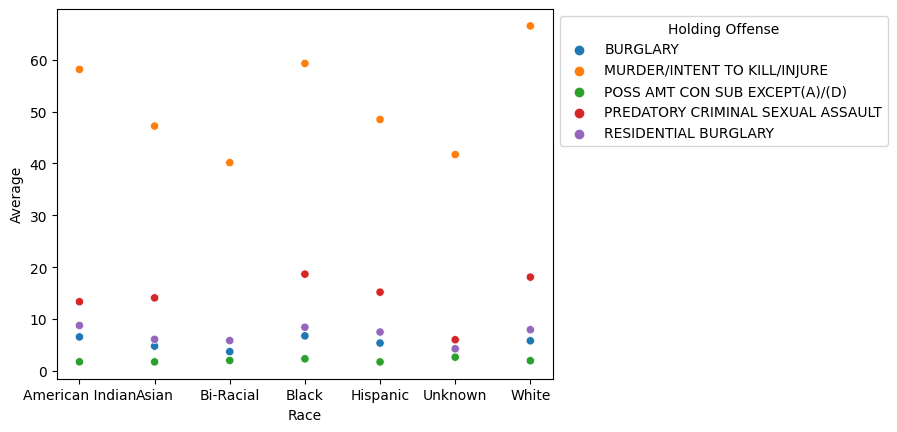

In [ ]:
ax = sns.scatterplot(data=pop_offenses, hue="Holding Offense", y="Average", x="Race")
sns.move_legend(ax, "upper left", bbox_to_anchor=(1, 1))

**LOOKING AT AVERAGE SENTENCE WITH CRIME CLASS - Raudel**


---
**Description of Visualization**: This visualization is supposed to further investigate the average sentence period for minorities and non-minorities, except this time we group the crimes by crime class. Crime classes are broken up into 5 groups: 1, 2, 3, 4, and X. Class 4 crimes are considered to be the least severe type of crimes, while Class X crimes are considered the most severe convictions.

**Findings**: This graph also shows that there is not a big diparity in sentencings for crimes by race. We wanted to see if lower level crimes had more of a disparity, like we predicted and have seen data about in the early parts of this project, but this data does not support the idea of racial disparity among races.





In [ ]:
temp = df["Crime Class"].unique()

crime_classes = ['Class 4', 'Class 3', 'Class 2', 'Class 1']

pop_offenses = df[["Sentence Years", "Crime Class", "Race"]]

pop_offenses["Sentence Years"] = np.where(pop_offenses["Sentence Years"] == "LIFE", 90, pop_offenses["Sentence Years"])
pop_offenses = pop_offenses[pop_offenses["Sentence Years"] != "SDP"]
pop_offenses = pop_offenses[pop_offenses["Sentence Years"] != "DEATH"]
pop_offenses = pop_offenses[pop_offenses["Sentence Years"] != "PEND"]
pop_offenses = pop_offenses[pop_offenses["Sentence Years"] != " "]
pop_offenses = pop_offenses[pop_offenses["Sentence Years"].notna()]

pop_offenses["Sentence Years"] = pop_offenses["Sentence Years"].astype(int)

# Grouping by Race and Holding Offense
pop_offenses = pop_offenses.groupby(["Race", "Crime Class"])["Sentence Years"].mean().reset_index(name="Average")
pop_offenses = pop_offenses[pop_offenses["Crime Class"].isin(crime_classes)]

pop_offenses

,Race,Crime Class,Average
0,American Indian,Class 1,8.635659
1,American Indian,Class 2,5.619565
2,American Indian,Class 3,3.389381
3,American Indian,Class 4,2.042017
6,Asian,Class 1,7.265985
7,Asian,Class 2,4.670792
8,Asian,Class 3,3.222222
9,Asian,Class 4,1.647799
13,Bi-Racial,Class 1,7.580000
14,Bi-Racial,Class 2,3.881818


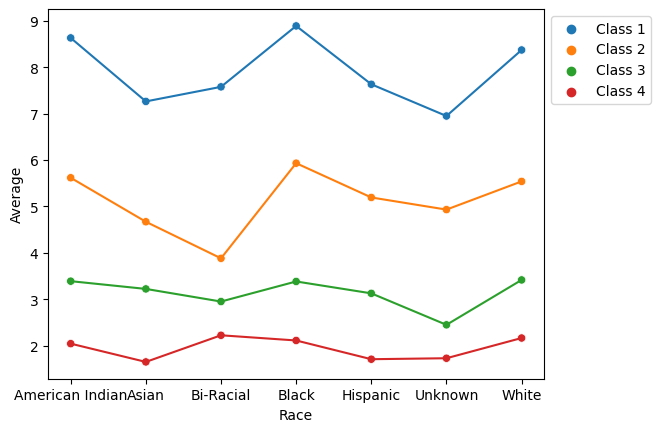

In [ ]:
ax = sns.scatterplot(data=pop_offenses, hue="Crime Class", y="Average", x="Race")
sns.lineplot(data=pop_offenses,hue="Crime Class", y="Average", x="Race",legend = False ,ax=ax)

ax.legend(loc = "upper left", bbox_to_anchor=(1, 1))

**COUNTIES WITH THE MOST CRIMES CONVICTED - Eddie**


---
**Hypothesis to test**: Counties with higher populations have more crimes convicted in comparison to lower populated counties.
We wanted to pursue this hypothesis mainly to see what area of Illinois has the highest number of crimes convicted. We believed that higher populated counties, which have big cities, popular stores, etc, would have more chance of a crime committed.

**Findings**: As we predicted, counties with higher populations have more convicted crimes than counties with lower populations. This seems a little obvious, however the graph does show us a very interesting finding. Counties near Chicago, which also happen to be some of the most populated, have the highest conviction numbers. This is interesting because it seems to show that these counties have the highest problem, and seems like these areas need to have the highest priority in solving this issue.



In [ ]:
# Read in the data to get the FIPS
df_sample = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/minoritymajority.csv')
df_sample = df_sample[df_sample['STNAME'] == 'Illinois']

df_sample = df_sample.sort_values(by="CTYNAME", ascending=True)
fips = df_sample['FIPS'].tolist()

# Read in IDOC data to get the county, and all incarcerations >= 2005
idoc_sample = df[["Sentencing County", "Sentence Date"]]
idoc_sample["Sentence Date"] = pd.to_datetime(idoc_sample["Sentence Date"], errors="coerce")
idoc_sample = idoc_sample[idoc_sample["Sentence Date"].notna()]

idoc_sample["Year"] = idoc_sample["Sentence Date"].dt.year
idoc_sample = idoc_sample[idoc_sample["Year"] >= 2005]

idoc_sample = idoc_sample.groupby(["Sentencing County"]).size().reset_index(name="Count")
idoc_sample = idoc_sample[idoc_sample["Sentencing County"] != "Out of state"]
idoc_sample = idoc_sample[idoc_sample["Sentencing County"] != "Dupage"]
idoc_sample = idoc_sample[idoc_sample["Sentencing County"] != "Dekalb"]
idoc_sample = idoc_sample[idoc_sample["Sentencing County"] != "LaSalle"]

idoc_sample = idoc_sample.sort_values(by="Sentencing County", ascending=True)
# counties = idoc_sample["Sentencing County"].tolist()
count = idoc_sample["Count"].tolist()

# Now counties, fips, count will be lists in order sorted by Counties

In [ ]:
fig2  = ff.create_choropleth(
    values= count,
    fips=fips,
    scope=['Illinois'],
    title='Crime Heatmap of Illinois Counties',
    show_state_data = True,
    legend_title= 'Number of Crimes Convicted per County (Since 2005)'
    # colorscale=colorscale,
)
fig2.show()

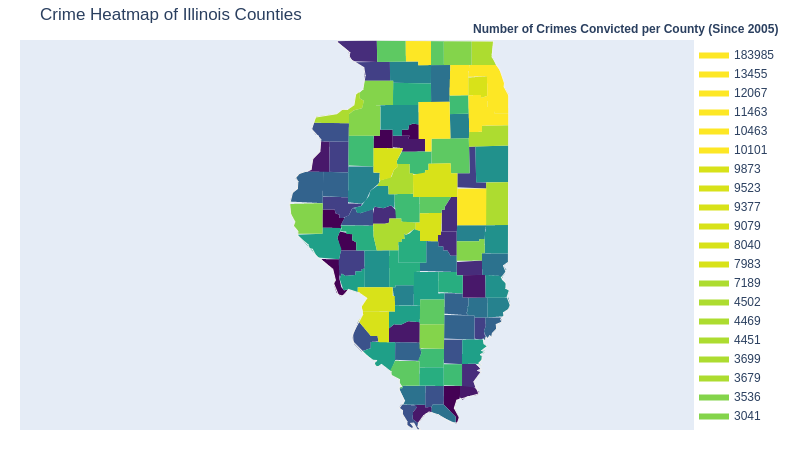

In [ ]:
gitly.show(fig2)

**DIVING DEEPER INTO RECOMMITTED CRIMES - Thoong**


---
**Hypothesis to test**: There are certain crimes that are committed where jail time does not result in resolution to the problem.
We chose to pursue this hypothesis because since prison populations as a whole are increasing, not just in Illinois, there must be some crimes that are being committed repetitively. If we could crack down on what some of those crimes are in Illinois, we could potentially come up with solutions that don't result in jail time, instead, some sort of alternative punishment.

**Findings**: As the graph shows, the most common recommitted crimes can be grouped into three main categories: Possession of Illegal Items (drugs or guns), Driving When Not Supposed To (either impaired or suspended license), and Criminal Activity (burglary).



In [ ]:
# find the top ten Holding Offenses based on count
readmitted = df[["Holding Offense", "Admission Type"]]

readmitted = readmitted.groupby(["Holding Offense", "Admission Type"]).size().reset_index(name="Count")
total_counts = readmitted.groupby("Holding Offense")['Count'].transform("sum")
readmitted["Percentage"] = (readmitted["Count"] / total_counts) * 100

readmitted = readmitted[readmitted["Admission Type"].str.lower() == "discharged & recommitted"]
readmitted = readmitted[readmitted["Count"] > 100]
readmitted = readmitted.sort_values(by=["Percentage"], ascending=False)

top_ten_readmitted = readmitted.head(10)
top_ten_readmitted

,Holding Offense,Admission Type,Count,Percentage
4901,DRIVING W/ SUSPEND/REVOKE LICENSE 10-14,Discharged & recommitted,585,66.326531
5058,DUI/6+,Discharged & recommitted,158,61.960784
3295,ATTEMPT MANU/DEL OTHER AMT NARC,Discharged & recommitted,122,61.928934
4941,DRIVING W/ SUSPEND/REVOKE LICENSE 4-9,Discharged & recommitted,919,61.471572
4910,DRIVING W/ SUSPEND/REVOKE LICENSE 15+,Discharged & recommitted,245,60.945274
6655,MANU/DEL HEROIN/SCHOOL/PUB HOUS/PARK,Discharged & recommitted,249,58.041958
8580,REVOKED/SUSPENDED 2ND DUI,Discharged & recommitted,954,54.545455
4888,DRIVING W/ REVOKE/SUSPEND LICENSE 2ND+,Discharged & recommitted,632,53.468697
2343,ARMED HABITUAL CRIMINAL,Discharged & recommitted,4203,53.189066
3121,ATTEMPT BURGLARY,Discharged & recommitted,1136,53.034547


[Text(0, 0, 'DRIVING W/ SUSPEND/REVOKE LICENSE 10-14'),
 Text(0, 1, 'DUI/6+'),
 Text(0, 2, 'ATTEMPT MANU/DEL OTHER AMT NARC'),
 Text(0, 3, 'DRIVING W/ SUSPEND/REVOKE LICENSE 4-9'),
 Text(0, 4, 'DRIVING W/ SUSPEND/REVOKE LICENSE 15+'),
 Text(0, 5, 'MANU/DEL HEROIN/SCHOOL/PUB HOUS/PARK'),
 Text(0, 6, 'REVOKED/SUSPENDED 2ND DUI'),
 Text(0, 7, 'DRIVING W/ REVOKE/SUSPEND LICENSE 2ND+'),
 Text(0, 8, 'ARMED HABITUAL CRIMINAL'),
 Text(0, 9, 'ATTEMPT BURGLARY')]

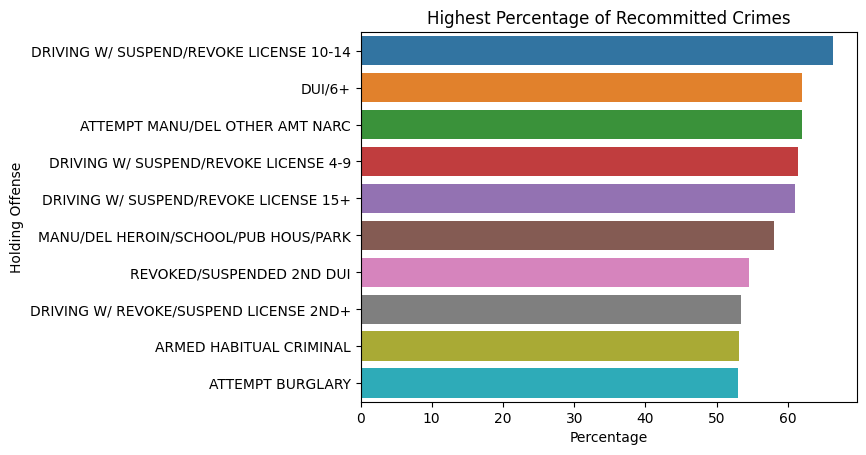

In [ ]:
ax = sns.barplot(data=top_ten_readmitted, y="Holding Offense", x="Percentage")
ax.set_title("Highest Percentage of Recommitted Crimes")

x_labels = top_ten_readmitted["Holding Offense"].tolist()

ax.set_yticklabels(labels=x_labels)

**COUNTIES WITH THE MOST RECOMMITTED CONVICTIONS - Eddie**


---
**Description of Visualization**: This visualization is supposed to show the top ten counties and how many of the total number of discharged and recommitted crimes they have. So for example, Cook county has 123,953 recommitted convictions, which is 52.49% of all recommitted convictions in Illinois.

**Findings**: This graph shows the enormous difference in the top county versus every other county. Cook county is by far the largest county in terms of recommitted convictions. This shows us where the focus should be placed when trying to get this numbers to decrease.





In [ ]:
df['Admission Type'] = df['Admission Type'].str.lower()
discharged_recommitted = df[["Sentencing County", "Admission Type"]]
discharged_recommitted = discharged_recommitted[discharged_recommitted["Admission Type"] == "discharged & recommitted"]
discharged_recommitted = discharged_recommitted.groupby(["Sentencing County", "Admission Type"]).size().reset_index(name="Count")
total_counts = discharged_recommitted.groupby("Admission Type")['Count'].transform("sum")
discharged_recommitted["Percentage"] = (discharged_recommitted["Count"] / total_counts) * 100
discharged_recommitted = discharged_recommitted.sort_values(by=["Percentage"], ascending=False)


top_ten_readmitted = discharged_recommitted.head(10)
top_ten_readmitted

,Sentencing County,Admission Type,Count,Percentage
15,Cook,discharged & recommitted,123953,52.491986
105,Winnebago,discharged & recommitted,7455,3.157066
103,Will,discharged & recommitted,6723,2.847076
9,Champaign,discharged & recommitted,6585,2.788635
57,Macon,discharged & recommitted,5868,2.484998
75,Peoria,discharged & recommitted,5759,2.438838
46,Kane,discharged & recommitted,5429,2.299089
66,McLean,discharged & recommitted,4980,2.108945
51,Lake,discharged & recommitted,4778,2.023402
86,Sangamon,discharged & recommitted,4613,1.953527


In [ ]:
fig = px.scatter(top_ten_readmitted, x= 'Sentencing County',y = 'Count',size  = 'Percentage',
                 color = "Percentage", hover_name= 'Sentencing County',
                 title = 'Top Counties with the Most Discharged & Recommitted Crimes in Illinois',
                 labels={'Count': 'Number of Discharged & Recommitted Crimes', 'Total Count': 'Total Count'},
                 size_max=60
                 )

fig.show()

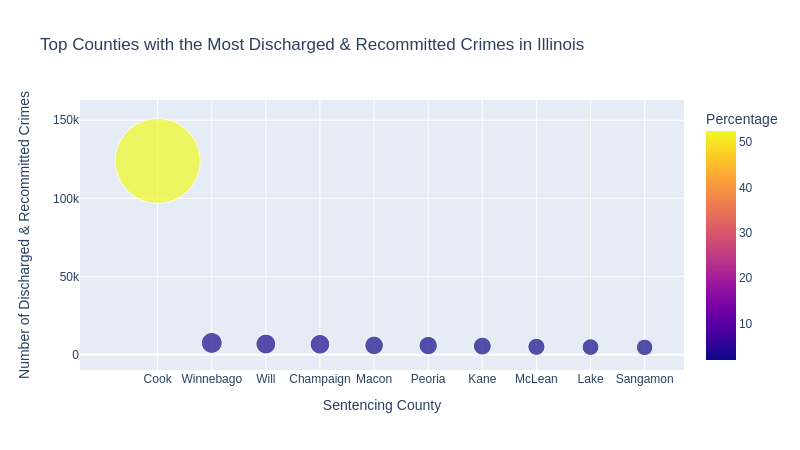

In [ ]:
# github
gitly.show(fig)

**FURTHER EXPLORATION OF THE AGE DISTRIBUTION OF RECOMMITTED CRIMES - Thoong**


---
**Description of Visualization**: This visualization is supposed to show another graph of the ages that are committing the most amount of crimes. It utilizes a funnel chart, with the ages around the outside on the circle, and the counts are represented by the circles within the big circle, going from 200-1600, incrementing by 200 each circle.

**Findings**: This graph shows the highest counts where the most amount of area is shaded, which for this graph goes from age 30 to 43, slowly decreasing after that age. It shows that the average population of people being convicted for crimes is people leaving their young adult years and entering the middle of their life.



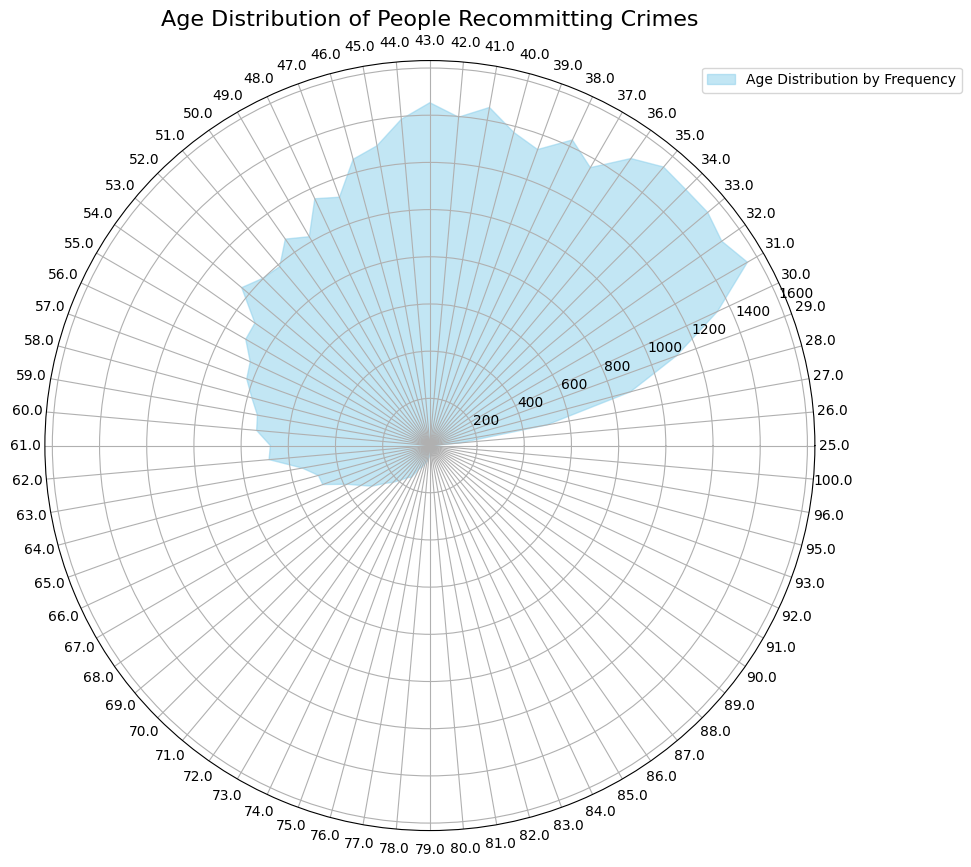

In [ ]:
df['Birth Year'] = df['Date of Birth'].astype(str).str[-4:]
df['Birth Year'] = pd.to_numeric(df['Birth Year'], errors='coerce')
current_year = 2023
df['Age'] = current_year - df['Birth Year']

df = df.dropna(subset=['Birth Year'])
df = df[(df['Age'] >= 0) & (df['Age'] <= 100)]
age_distribution = df['Age'].value_counts().sort_index()

categories = age_distribution.index
values = age_distribution.values

num_categories = len(categories)

angles = np.linspace(0, 2 * np.pi, num_categories, endpoint=False).tolist()

values = np.concatenate((values, [values[0]]))
angles += angles[:1]

fig, ax = plt.subplots(figsize=(10, 10), subplot_kw=dict(polar=True))
ax.fill(angles, values, color='skyblue', alpha=0.5)

ax.set_xticks(angles[:-1])
ax.set_xticklabels([str(age) for age in categories], fontsize=10)
ax.set_title('Age Distribution of People Recommitting Crimes', fontsize=16)
ax.legend(['Age Distribution by Frequency'], loc='upper right', bbox_to_anchor=(1.2, 1))

plt.show()

**PRISON CONVICTIONS OF VETERANS - Quang**


---
**Hypothesis to test**: There is an increasing percentage of former veterans that are ending up behind bars due to inadequate resources towards that group.
This is a hypothesis we chose to pursue because a large number of former veterans do not have the support for a normal life after their sacrifices for this country. A lot of them end up on the street without any support, and a majority of veterans deal with emotions due to their time serving. If there is an increase in veterans behind bars, resources supporting veterans must be allocated, instead of allocating more for prisons.

**Findings**: What we found from this graph was that people who identify that they have a veteran status do not typically have issues with getting convicted to the Illinois prison system. The trend also seems to be steady throughout the years, so there seems to not be a major issue.



In [ ]:
veteran2 = df[["Veteran Status", "Sentence Years", "Sentence Date"]]

# Getting rid of the strings in Sentence Years, and then converting the ints to be type int
veteran2["Sentence Years"] = np.where(veteran2["Sentence Years"] == "LIFE", 90, veteran2["Sentence Years"])
veteran2 = veteran2[veteran2["Sentence Years"] != "SDP"]
veteran2 = veteran2[veteran2["Sentence Years"] != "DEATH"]
veteran2 = veteran2[veteran2["Sentence Years"] != "PEND"]
veteran2 = veteran2[veteran2["Sentence Years"] != " "]
veteran2 = veteran2[veteran2["Sentence Years"].notna()]
veteran2 = veteran2[veteran2["Veteran Status"].notna()]

veteran2["Sentence Years"] = veteran2["Sentence Years"].astype(int)

# making the minimum year 2005
veteran2["Sentence Date"] = pd.to_datetime(veteran2["Sentence Date"], errors="coerce")
veteran2 = veteran2[veteran2["Sentence Date"].notna()]

veteran2["Year"] = veteran2["Sentence Date"].dt.year
veteran2 = veteran2[veteran2["Year"] >= 2005]
veteran2 = veteran2.groupby(["Veteran Status", "Year"]).size().reset_index(name='Count')
veteran2 = veteran2.sort_values(by="Year")
veteran2

,Veteran Status,Year,Count
0,No,2005,15582
19,Unknown,2005,17493
38,Yes,2005,748
1,No,2006,16747
20,Unknown,2006,21154
39,Yes,2006,815
2,No,2007,14403
21,Unknown,2007,21047
40,Yes,2007,824
3,No,2008,13412


[Text(0, 0, '2005'),
 Text(1, 0, '2006'),
 Text(2, 0, '2007'),
 Text(3, 0, '2008'),
 Text(4, 0, '2009'),
 Text(5, 0, '2010'),
 Text(6, 0, '2011'),
 Text(7, 0, '2012'),
 Text(8, 0, '2013'),
 Text(9, 0, '2014'),
 Text(10, 0, '2015'),
 Text(11, 0, '2016'),
 Text(12, 0, '2017'),
 Text(13, 0, '2018'),
 Text(14, 0, '2019'),
 Text(15, 0, '2020'),
 Text(16, 0, '2021'),
 Text(17, 0, '2022'),
 Text(18, 0, '2023')]

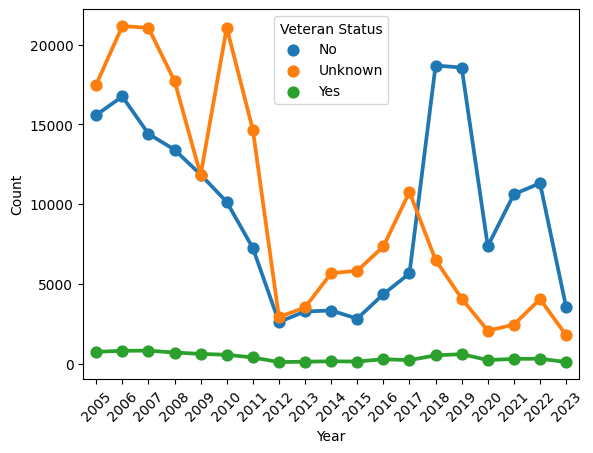

In [ ]:
ax = sns.pointplot(data=veteran2, x="Year", y="Count", hue="Veteran Status")
ax.set_xticklabels(labels=[2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023], rotation=45)

**CRIMES VETERANS GET CONVICTED FOR THE MOST - Quang**


---
**Description of Visualization**: This visualization shows the 10 most common crimes that veterans get convicted for. The goal is to show people that although the number of crimes they get convicted for isn't high, there are still issues that need to be addressed to further lower than trend.

**Findings**: We see that the main crimes that veterans get convicted for are murder, sexual assault, and burglary. This can mean a few things. Veterans go through very difficult experiences when they sacrifice their lives for their country, and harm towards others (like murder and sexual assault) can be a byproduct of those experiences. Burglary could mean that there is a lack of further funding to help these veterans live their lives after their experiences. We can see that there can be resources provided or actions that can take place in order to further decrease these numbers.





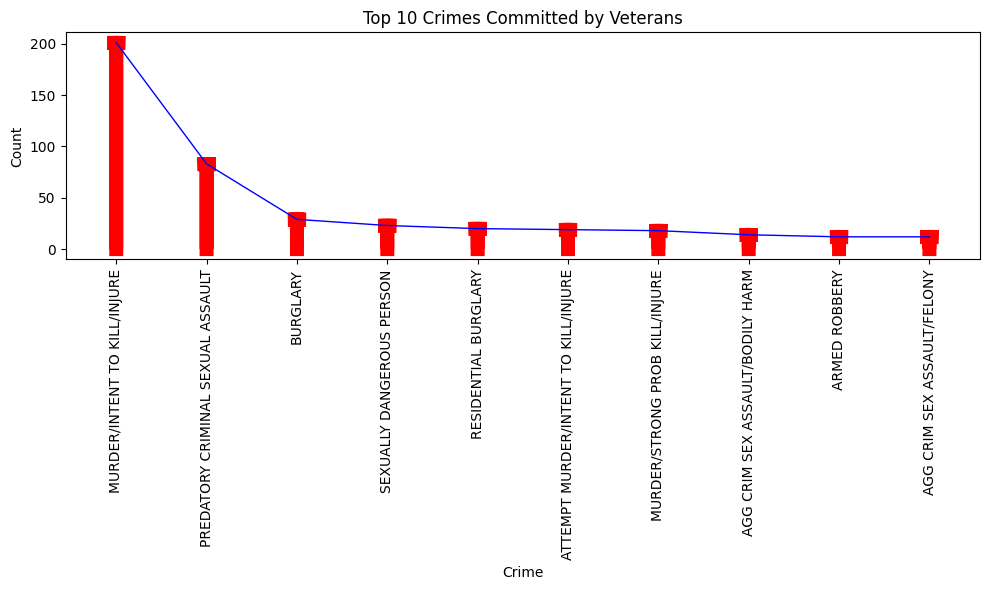

In [ ]:
import plotly.graph_objects as go

# Filter the DataFrame to include only rows where Veteran Status is 'Yes'
veterans_df = df[df['Veteran Status'] == 'Yes']

# Group the data by crime and count the number of occurrences
crime_counts = veterans_df['Holding Offense'].value_counts().head(10)  # Select top 10 crimes

top_10_crimes = crime_counts.head(10)

# Create the plot
plt.rcParams["figure.figsize"] = [10.00, 6.00]
plt.rcParams["figure.autolayout"] = True

x = np.arange(len(top_10_crimes))
y = top_10_crimes.values

plt.plot(x, y, c='b', lw=1)

# Add arrows for each crime count
for i in range(len(x)):
    plt.arrow(x[i], 0, 0, y[i], shape='full', lw=10,
              length_includes_head=True, head_width=0.2, color='r')

# Set the x-axis labels to the crimes
plt.xticks(x, top_10_crimes.index.tolist(), rotation=90)

# Set the plot title and labels
plt.title('Top 10 Crimes Committed by Veterans')
plt.xlabel('Crime')
plt.ylabel('Count')

# Show the plot
plt.show()

# ML / Stats

**PREDICTING ADMISSION TYPE BASED ON 3 CATEGORIES -Eddie**


---

**Process**: This ML analysis performs a logistic regression classification task on the dataset. The goal is to use categories "Race", "Holding Offense", and "Sentence Years" in order to be able to predict "Admission Type".

**Inferences**: Our analysis concludes that the model seems to perform better when it comes to predicting class 0 compared to predicting for class 1. As you can see from our results, predicting class 0 out performs class 1 in precision, recall, and f-1 scores.The overall accuracy obtained was 70%.

In [ ]:
from sklearn.model_selection import train_test_split as tts
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.preprocessing import OneHotEncoder

In [ ]:
ml1 = df[["Race", "Admission Type", "Holding Offense", "Sentence Years"]]

# years to be ints
ml1["Sentence Years"] = np.where(ml1["Sentence Years"] == "LIFE", 90, ml1["Sentence Years"])
ml1 = ml1[ml1["Sentence Years"] != "SDP"]
ml1 = ml1[ml1["Sentence Years"] != "DEATH"]
ml1 = ml1[ml1["Sentence Years"] != "PEND"]
ml1 = ml1[ml1["Sentence Years"] != " "]

ml1 = ml1[ml1["Sentence Years"].notna()]
ml1 = ml1[ml1["Race"].notna()]
ml1 = ml1[ml1["Admission Type"].notna()]
ml1 = ml1[ml1["Holding Offense"].notna()]

ml1["Sentence Years"] = ml1["Sentence Years"].astype(int)
ml1["Admission Type"] = np.where(ml1["Admission Type"].str.lower() == "discharged & recommitted", 1, 0)

ml1

,Race,Admission Type,Holding Offense,Sentence Years
596041,White,1,PREDATORY CRIMINAL SEXUAL ASSAULT,13
596042,White,1,ATTEMPT MURDER/INTENT TO KILL/INJURE,50
596043,White,1,ARMED ROBBERY,60
596044,Black,0,AGG CRIM SEX ASSAULT/WEAPON,60
596045,Black,0,MURDER/INTENT TO KILL/INJURE,90
...,...,...,...,...
641607,Black,0,AGG DOMESTIC BATTERY/STRANGLE,3
641608,Hispanic,0,DUI/4TH+/LIC SUSP OR REVOKE,4
641609,Black,0,MANU/DEL OTHER AMT NARC SCHED I&II,3
641610,Black,0,AGG CRIM SEX ASSAULT/WEAPON,22


In [ ]:
encoder = OneHotEncoder()
X = encoder.fit_transform(ml1[["Holding Offense", "Race", "Sentence Years"]])

y = ml1["Admission Type"]

X_train, X_test, y_train, y_test = tts(X, y)

classifier = LogisticRegression()

classifier.fit(X_train, y_train)

y_predictions = classifier.predict(X_test)

print("Acc %:",metrics.accuracy_score(y_test, y_predictions)*100)
print("Report:")
print(metrics.classification_report(y_test, y_predictions))

Acc %: 67.84517721742198
Report:
              precision    recall  f1-score   support

           0       0.70      0.85      0.77      7056
           1       0.62      0.39      0.48      4286

    accuracy                           0.68     11342
   macro avg       0.66      0.62      0.62     11342
weighted avg       0.67      0.68      0.66     11342



/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



**PREDICTING HOLDING OFFENSES -Kacper**


---

**Process**: For this machine learning analysis, we wanted to focus on the columns Admission Type, Crime Class, Holding Offense, and Sentence Years. We wanted to train the data on Admission Type, Crime Class, and Sentence Years to see if our classifier could predict the Holding Offense.
We used a linear SVC classification, and we fit the data using StandardScaler, purely because the data seemed too big and the classifier would take too long to run when I ran it with just SVC and no Standard Scalar.

**Findings**: This classifier gave us a 76% accuracy on the Holding Offense it would give us. This means that we can get a fairly accurate result when we are only given Crime Class, Holding Offense, and Sentence Years. I also tested it with an example input, and it returns the Admission Type "Burglary", which is the correct holding offense.

In [ ]:
#Importing Libraries
from sklearn import datasets
from sklearn import metrics
from sklearn import preprocessing
from sklearn import svm
from sklearn.svm import LinearSVC
from sklearn.model_selection import train_test_split as tts
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.cluster import KMeans
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier

In [ ]:
top_ten_crimes = df[["Holding Offense"]]
top_ten_crimes = top_ten_crimes.groupby(["Holding Offense"]).size().reset_index(name="Count")
top_ten_crimes = top_ten_crimes.sort_values(by="Count", ascending=False)
top_ten_crimes = top_ten_crimes.head(10)
# top_ten_crimes

top_ten_list = top_ten_crimes["Holding Offense"].tolist()
# top_ten_list

In [ ]:
ml2 = df[["Admission Type", "Crime Class", "Holding Offense", "Sentence Years"]]

# years to be ints
ml2["Sentence Years"] = np.where(ml2["Sentence Years"] == "LIFE", 90, ml2["Sentence Years"])
ml2 = ml2[ml2["Sentence Years"] != "SDP"]
ml2 = ml2[ml2["Sentence Years"] != "DEATH"]
ml2 = ml2[ml2["Sentence Years"] != "PEND"]
ml2 = ml2[ml2["Sentence Years"] != " "]
ml2 = ml2[ml2["Sentence Years"].notna()]

ml2["Sentence Years"] = ml2["Sentence Years"].astype(int)

# get the top 10 crimes
ml2 = ml2[ml2["Holding Offense"].isin(top_ten_list)]

In [ ]:
# Splitting Data into Training and Testing data
encoder = OneHotEncoder()
X = encoder.fit_transform(ml2[["Admission Type", "Crime Class", "Sentence Years"]])

y = ml2["Holding Offense"]

X_train, X_test, y_train, y_test = tts(X, y, test_size=30/100, random_state=None)

# SVM Classifier
classifier = LinearSVC()

sc = StandardScaler(with_mean = False)
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

# Train
classifier.fit(X_train, y_train.ravel())

# Predictions
y_predictions = classifier.predict(X_test)

#Accuracy
print("Acc %:",metrics.accuracy_score(y_test, y_predictions)*100)

Acc %: 77.08542171921316


/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


In [ ]:
# Testing with data directly from trained and tested data
test_data = [["Direct from court", "Class 2", 4]]
test_data_enc = encoder.transform(test_data)

print(classifier.predict(test_data_enc))

['BURGLARY']


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but OneHotEncoder was fitted with feature names
  warnings.warn(


**PREDICTING SENTENCING COUNTY -Kacper**


---

**Process**: In this Machine Learning Analysis, we utilized a Decision Tree classifier to try and see how accurately it could predict the Sentence County given the holding offense and custody date. This is supposed to link back to our visualization about counties and their most common crimes that offenders were convicted for. We used a decision tree to try and test if it would provide more accuracy compared to other classifiers, such asthe Linear SVC.

**Findings**: With the Decision Tree classifier, we didn't really get very good precision with our classifications. The only county that had a high precision and high recall was Cook, and that has the most amount of support for it as well. I believe that the reasoning behind these low numbers is the type of classifier we chose. It doesn't seem like Decision Trees make the best option based on the inputs we gave it.

In [ ]:
from sklearn.metrics import accuracy_score, classification_report

In [ ]:
# Cleaning up data
# Changing sentence years to be only numeric, then separating them into categories of SHORT, MED, and LONG

ml3 = df[["Holding Offense", "Custody Date", "Sentencing County"]]

ml3 = ml3[ml3["Holding Offense"].notna()]
ml3 = ml3[ml3["Custody Date"].notna()]
ml3 = ml3[ml3["Sentencing County"].notna()]

encoder = OneHotEncoder()
X = encoder.fit_transform(ml3[["Holding Offense", "Custody Date"]])
y = ml3["Sentencing County"]

X_train, X_test, y_train, y_test = tts(X, y, test_size=30/100, random_state=None)

#Decision Tree
classifier = DecisionTreeClassifier()
classifier.fit(X_train, y_train.ravel())

#predict
pred = classifier.predict(X_test)

#Accuracy
accuracy = accuracy_score(y_test, pred)
classification = classification_report(y_test, pred)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification)

Accuracy: 0.6588974403211486
Classification Report:
               precision    recall  f1-score   support

       Adams       0.41      0.49      0.44      1973
   Alexander       0.60      0.56      0.58       235
        Bond       0.61      0.41      0.49       381
       Boone       0.60      0.46      0.52       913
       Brown       0.47      0.41      0.44        51
      Bureau       0.53      0.41      0.46       473
     Calhoun       0.63      0.39      0.49        84
     Carroll       0.60      0.39      0.47       165
        Cass       0.52      0.33      0.40       198
   Champaign       0.55      0.51      0.52      5690
   Christian       0.61      0.46      0.52       612
       Clark       0.62      0.42      0.50       370
        Clay       0.56      0.30      0.39       302
     Clinton       0.57      0.39      0.46       565
       Coles       0.61      0.47      0.53      1428
        Cook       0.68      0.91      0.78    116428
    Crawford       0.25     

**PREDICTING PARENT INSTITUTION - Raudel**


---

**PROCESS**: This ML analysis is supposed to predict the parent institution that a person gets sentenced to based on the Sentencing County and Holding Offense. We are using a Decision Tree Classifier in order to make this prediction. We also had to use LabelEncoders() get would change non-numeric values to be numeric in order to be used in the classifier.

**FINDINGS**: We found that the Decision Tree Classifier was very poor at predicting the insitution for some reason, giving us an accuracy of 12.76%. This potentially may be due to the fact that there aren't a lot of things for the classifier to make a decision on, but we aren't sure.

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.preprocessing import LabelEncoder


features = ['Sentencing County','Holding Offense']
target = 'Parent Institution'

df_subset = df.dropna(subset= features + [target])


label_encoder = LabelEncoder()
for feature in features + [target]:
  df_subset[feature] = label_encoder.fit_transform(df_subset[feature])

X_train, X_test, y_train, y_test = train_test_split(df_subset[features], df_subset[target], test_size=0.2, random_state=42)
model = DecisionTreeClassifier(random_state=42)
model.fit(X_train, y_train)


y_pred = model.predict(X_test)

y_test_original = label_encoder.inverse_transform(y_test)
y_pred_original = label_encoder.inverse_transform(y_pred)

output_df = pd.DataFrame({
    'Sentencing County': X_test['Sentencing County'],
    'Holding Offense': X_test['Holding Offense'],
    'Actual Parent Institution': y_test_original,
    'Predicted Parent Institution': y_pred_original
})


print(output_df)
accuracy = accuracy_score(y_test_original, y_pred_original)
classification = classification_report(y_test_original, y_pred_original)

print(f"Accuracy: {accuracy}")
print("Classification Report:\n", classification)

        Sentencing County  Holding Offense Actual Parent Institution  \
637631                 28              764                     Logan   
205580                 52             1055                  Vandalia   
639352                 83             1726                 Centralia   
142115                 15             1449             Pinckneyville   
539447                103              416                     Logan   
...                   ...              ...                       ...   
28115                  15              237         Illinois River CC   
392863                 15             1215               Sheridan CC   
316199                 15             1525                 Menard CC   
625730                  9             1368                    Graham   
44222                  15              142                 Vienna CC   

       Predicted Parent Institution  
637631                      Decatur  
205580               East Moline CC  
639352               

**CHECKING LIKELIHOOD SOMEONE WILL REOFFEND -Quang Le**


---

**Process**: In this ML analysis, we utilize a Random Forest Classifier to predict the likelihood that someone will reoffend, based on Sex, Race, Veteran Status, Sentence Years, and Sentence Months.


In [ ]:
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
columns = ['Admission Type', 'Sentencing County', 'Age', 'Crime Class']
analysis_df = df[columns]
print(analysis_df)

                       Admission Type Sentencing County   Age Crime Class
596041       discharged & recommitted         Winnebago  79.0     Class X
596042       discharged & recommitted            Jasper  74.0     Class X
596043       discharged & recommitted              Cook  77.0     Class X
596044  parole violator, new sentence              Cook  69.0     Class X
596045              direct from court              Will  67.0      Murder
...                               ...               ...   ...         ...
641607              direct from court             Henry  40.0     Class 2
641608              direct from court             Henry  64.0     Class 2
641609              direct from court             Henry  33.0     Class 2
641610              direct from court              Cook  37.0     Class X
641611              direct from court              Cook  27.0     Class 1

[45566 rows x 4 columns]


In [ ]:
#Start training the model
le = LabelEncoder()
df['Admission Type'] = le.fit_transform(df['Admission Type'])
df['Sentencing County'] = le.fit_transform(df['Sentencing County'])
X = df[['Admission Type', 'Sentencing County', 'Age']]
y = df['Crime Class']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
model = DecisionTreeClassifier()
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
accuracy

0.30908492429229756

# Additional Work

**WHICH DATES HAVE THE MOST CRIMES COMMITTED - Kacper & Raudel**


---

This visualization is supposed to show which dates typically have the most crime committed (from 2005-2023). As the visualization shows, a lot of the convictions happen around the end of year, which we found suprising because we thought that certain days (typically near holidays) would see the highest number, which wasn't necessarily true according to the heatmap.

In [ ]:
!pip install plotly-calplot

In [14]:
from gitly.colab.plot import GitlyPlotter
from gitly.colab.plot import GitlyPlotter
gitly = GitlyPlotter('github')

In [15]:
excomp = df[["Custody Date"]]

excomp["Custody Date"] = pd.to_datetime(excomp["Custody Date"], errors="coerce")
excomp = excomp[excomp["Custody Date"].notna()]

excomp["Custody Date"] = excomp["Custody Date"].apply(lambda x: x.replace(year=2020))
excomp["Count"] = excomp.groupby("Custody Date")["Custody Date"].transform("count")
excomp = excomp.sort_values(by="Custody Date", ascending=True)
excomp = excomp.drop_duplicates(subset="Custody Date")

excomp

,Custody Date,Count
241233,2020-01-01,26
662836,2020-01-02,597
69058,2020-01-03,1252
770294,2020-01-04,1367
98214,2020-01-05,1497
...,...,...
575843,2020-12-27,824
746793,2020-12-28,821
85563,2020-12-29,899
242042,2020-12-30,740


In [16]:
from plotly_calplot import calplot
fig = calplot(excomp,
              x="Custody Date",
              y="Count",
              colorscale="purples",
              month_lines_width=3,
              month_lines_color="#000")
fig.show()

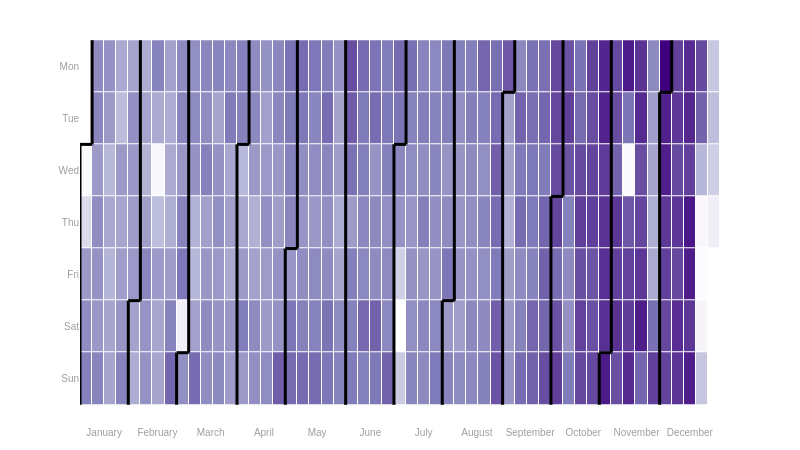

In [17]:
gitly.show(fig)

**COMPARING THE NUMBER OF CONVICTIONS BY GENDER (COOK COUNTY) - Kacper**

[idea](https://dataviz.unhcr.org/tools/python/python_stacked_area_chart.html)

---

**PROCESS**: In this visualization, we wanted to compare and see how the number of convictions for males and females in Cook county from 2005-2023 differ. We first sorted the data by only using rows with "Cook" as the Sentencing County, and also only allowing the gender to be Male and Female. We then grouped by the gender and year, and made sure that year was >= 2005. After that, we used matplotlib's plot.area in order to create this stacked graph, and got as output a graph with male as orange and female as blue.

**FINDINGS**: The findings are sort of what we expected. The number of males convicted is substantially larger than number of females convicted in Cook. This was pretty much what we expected to see, because overall the female population in prison is very small. We do get to see the trends of the number of crimes increasing/decreasing throughout the years, so we get to see any spikes or low points within the data.

In [ ]:
gender_county = df[["Sex", "Sentencing County", "Custody Date"]]
gender_county = gender_county[gender_county["Sex"] != ' ']
gender_county = gender_county[gender_county["Sentencing County"] == "Cook"]

gender_county["Custody Date"] = pd.to_datetime(gender_county["Custody Date"], errors="coerce")
gender_county = gender_county[gender_county["Custody Date"].notna()]

gender_county["Year"] = gender_county["Custody Date"].dt.year
gender_county = gender_county[gender_county["Year"] >= 2005]
gender_county = gender_county.groupby(["Sex", "Year"]).size().reset_index(name='Count')
gender_county = gender_county.sort_values(by=["Year", "Sex"])

gender_county

,Sex,Year,Count
0,Female,2005,1019
19,Male,2005,17575
1,Female,2006,1045
20,Male,2006,19370
2,Female,2007,1059
21,Male,2007,17894
3,Female,2008,987
22,Male,2008,16513
4,Female,2009,834
23,Male,2009,16777


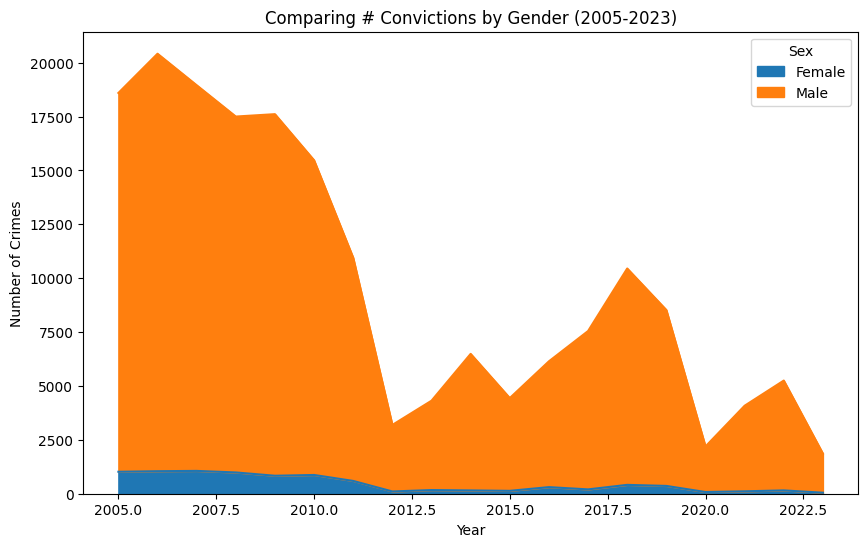

In [ ]:
fig, ax = plt.subplots(figsize=(10, 6))
stacked = gender_county.pivot(index='Year', columns='Sex', values='Count')
stacked.plot.area(ax=ax, stacked=True)

plt.title('Comparing # Convictions by Gender (2005-2023)')
plt.xlabel('Year')
plt.ylabel('Number of Crimes')
plt.legend(title='Sex')
plt.show()

**SENTENCE YEARS FOR TOP 5 CRIMES (by Gender)- Raudel**


---

**PROCESS**: We wanted to see the difference in sentence years for each sex for the top 5 most committed crimes in Illinois, using seaborn's FacetGrid to show this.

**FINDINGS**: The graph shows that overall, males typically received longer sentences than females did for the same crime, except for armed robbery with a firearm, where females had almost 2x the duration. It is also interesting to point out that the distribution for sentence years isn't the same for each sex. For example, male's received a longer sentence for armed robbery without a firearm compared to armed robbery with a firearm, but females received a longer sentence for armed robbery with a firearm.

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:712: UserWarning:

Using the barplot function without specifying `order` is likely to produce an incorrect plot.



Text(0.5, 0.98, 'Distribution of Sentence Years for Top 5 Crimes in Class X by Sex')

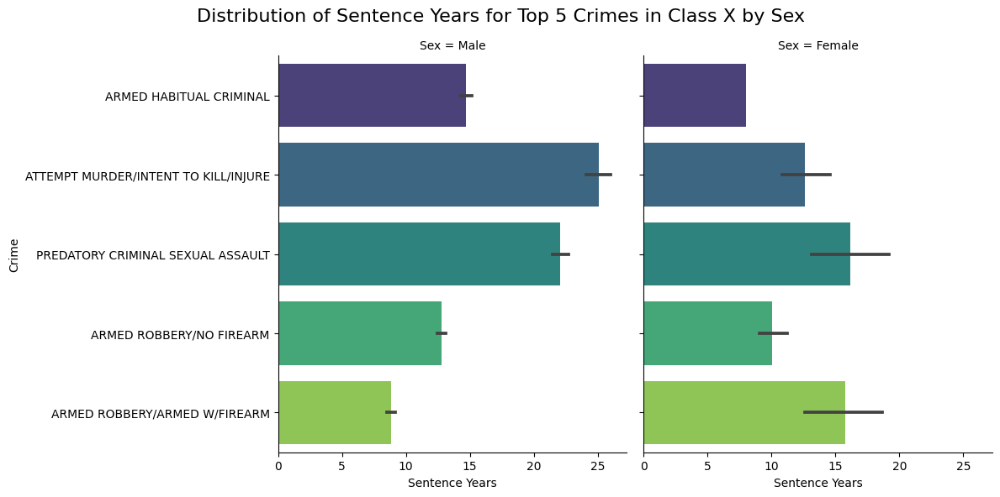

In [ ]:
class_x = df[df['Crime Class']=='Class X']
most_committed_x = class_x['Holding Offense'].value_counts()

top_5 = most_committed_x.head(5).index

top_5_data = class_x[class_x['Holding Offense'].isin(top_5)]
top_5_data['Sentence Years'] = pd.to_numeric(top_5_data['Sentence Years'], errors='coerce')

sex  = sns.FacetGrid(top_5_data , col = 'Sex',height =6 ,aspect = 1)
sex.map(sns.barplot,'Sentence Years','Holding Offense',palette = 'viridis')


sex.set_axis_labels('Sentence Years', 'Crime')
plt.subplots_adjust(top=0.85)
sex.fig.suptitle('Distribution of Sentence Years for Top 5 Crimes in Class X by Sex', fontsize=16)


**TITLE FOR EXTRA COMPONENT - TODO**


---

Description of what extra component is doing

In [20]:
fig = px.scatter_3d(
    df,
    x='Sentence Years',
    y='Sentence Months',
    z='Truth in Sentencing',
    color='Crime Class',
    size_max=10,
    opacity=0.7,
    title='3D Scatter Plot of Sentence Years, Sentence Months, and Truth in Sentencing'
)
fig.show()

**WHICH INSTITUTIONS ARE FEMALES SENTENCED TO - Raudel**

---

**PROCESS**: Derived from the dataset containing the important information need such as Sex and Parent Institution the chart provides a depiction of the representation of females in various facilities throughout the state of Illinois. To enhance readabilty a threshhold was created to selectively label slices with percentages above a certain level, mitigating clutter and enhancing readability(The threshold is 2%). Each labeled slice shows the corresponding percentage of the total female population currently incarcerated.


**FINDINGS**: We find that the majority of females that are incarcerated are most within 6 different parent institution. Those 6 being Logan,Dwight CC, Lincoln CC, Decatur CC, Decatur, and Logan CC. There are a smaller amount of women held in other institutions but their number is negligible. This is  because the main 6 insitutions are the main institutions designed to hold females while the others are not designed for such a task and are instead being used to temporarily hold female prisoners until they can be sent to one of the 6 major female holding institutions.   

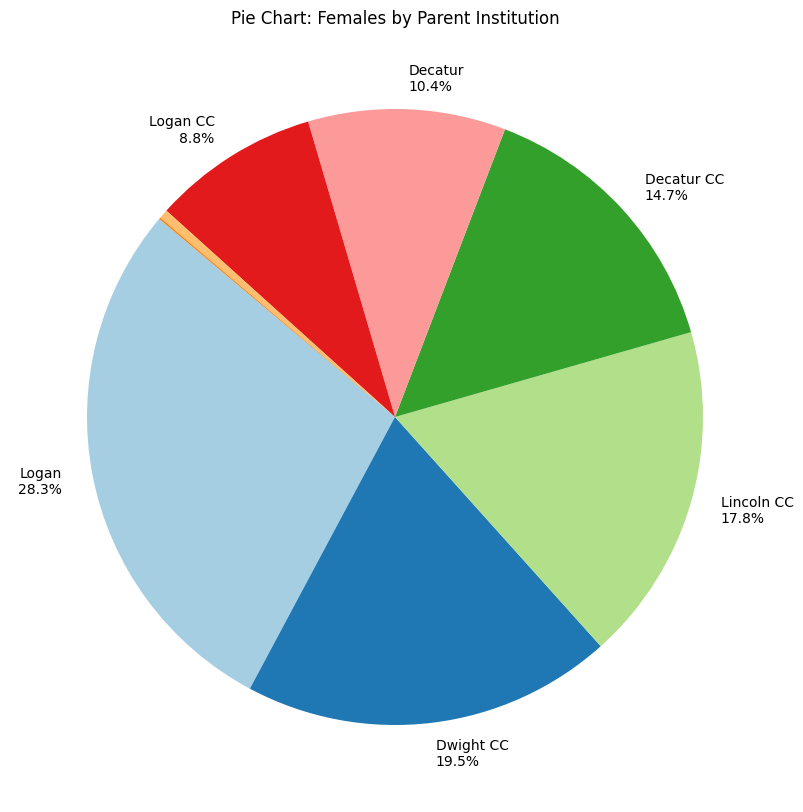

In [ ]:
from pywaffle import Waffle
from matplotlib.patches import Rectangle

threshold = 2.0

# Identify small percentages get ride of any that are negligable
small_percentages = grouped_data['Count'] / grouped_data['Count'].sum() * 100 < threshold

# Label only the slices with percentages above the threshold get ride of any that are negligable
labels = [f'{label}\n{percent:.1f}%' if not small else '' for label, percent, small in zip(grouped_data['index'], grouped_data['Count'] / grouped_data['Count'].sum() * 100, small_percentages)]

plt.figure(figsize=(10, 10))
plt.pie(grouped_data['Count'], labels=labels, autopct='', startangle=140, colors=plt.cm.Paired.colors)
plt.title('Pie Chart: Females by Parent Institution')
plt.show()